# TACO Inspection Demo

This notebook contains several independent scripts that show how to load and visualize the dataset stats and annotated images:
- Section 1 shows the dataset stats
- Section 2 show the class hierarchical structure: super classes and classes
- Section 3 shows TACO images along with their segmentation masks

But first we need to load the annotations and some python libraries:

In [1]:
%matplotlib inline
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

dataset_path = './data'
anns_file_path = dataset_path + '/' + 'annotations.json'

# Read annotations
with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

print('Dataset info:', dataset.keys())
categories = dataset['categories']
anns = dataset['annotations']
imgs = dataset['images']
nr_cats = len(categories)
nr_annotations = len(anns)
nr_images = len(imgs)

# Load categories and super categories
cat_names = []
super_cat_names = []
super_cat_ids = {}
super_cat_last_name = ''
nr_super_cats = 0
for cat_it in categories:
    cat_names.append(cat_it['name'])
    super_cat_name = cat_it['supercategory']
    # Adding new supercat
    if super_cat_name != super_cat_last_name:
        super_cat_names.append(super_cat_name)
        super_cat_ids[super_cat_name] = nr_super_cats
        super_cat_last_name = super_cat_name
        nr_super_cats += 1

print('Number of super categories:', nr_super_cats)
print('Number of categories:', nr_cats)
print('Number of annotations:', nr_annotations)
print('Number of images:', nr_images)

Dataset info: dict_keys(['info', 'images', 'annotations', 'scene_annotations', 'licenses', 'categories', 'scene_categories'])
Number of super categories: 28
Number of categories: 60
Number of annotations: 4784
Number of images: 1500


## 1.  Dataset statistics

This shows the number of annotations per category:

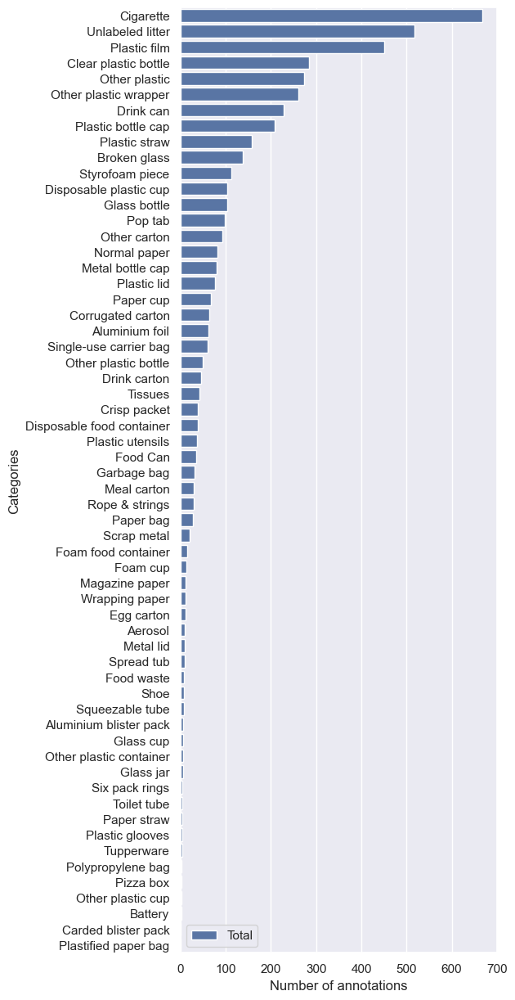

In [2]:
# Count annotations
cat_histogram = np.zeros(nr_cats,dtype=int)
for ann in anns:
    cat_histogram[ann['category_id']] += 1

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,15))

# Convert to DataFrame
df = pd.DataFrame({'Categories': cat_names, 'Number of annotations': cat_histogram})
df = df.sort_values(by='Number of annotations', axis=0, ascending=False)

# Plot the histogram
# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Categories", data=df,
            label="Total", color="b")

# fig = plot_1.get_figure()
# fig.savefig("output.png")

and this shows the number of annotations per super category:

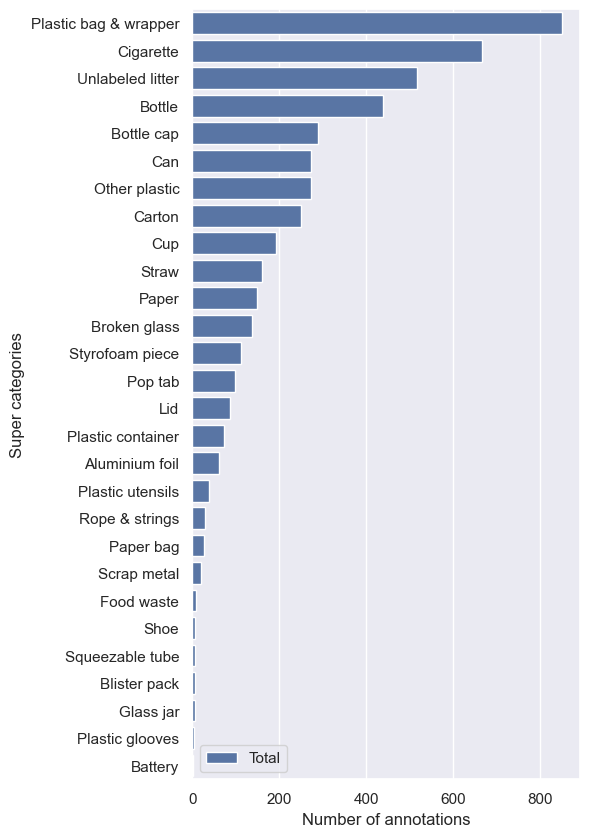

In [3]:
cat_ids_2_supercat_ids = {}
for cat in categories:
    cat_ids_2_supercat_ids[cat['id']] = super_cat_ids[cat['supercategory']]
# print(cat_ids_2_supercat_ids)
# print(super_cat_ids)

# Count annotations
super_cat_histogram = np.zeros(nr_super_cats,dtype=int)
for ann in anns:
    cat_id = ann['category_id']
    super_cat_histogram[cat_ids_2_supercat_ids[cat_id]] +=1
    
# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,10))

# Convert to DataFrame
d ={'Super categories': super_cat_names, 'Number of annotations': super_cat_histogram}
df = pd.DataFrame(d)
df = df.sort_values(by='Number of annotations', axis=0, ascending=False)

# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Super categories", data=df,
            label="Total", color="b")
#plot_1.set_title('Annotations per super category',fontsize=20)   

### 1.1  Background stats

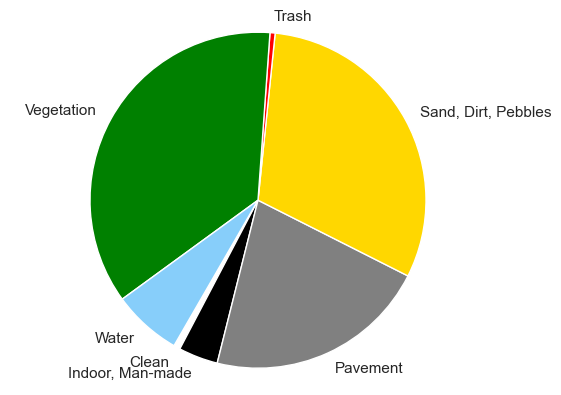

In [4]:
# Get scene cat names
scene_cats = dataset['scene_categories']
scene_name = []
for scene_cat in scene_cats:
    scene_name.append(scene_cat['name'])

nr_scenes = len(scene_cats)
scene_cat_histogram = np.zeros(nr_scenes,dtype=int)

for scene_ann in dataset['scene_annotations']:    
    scene_ann_ids = scene_ann['background_ids']
    for scene_ann_id in scene_ann_ids:
        if scene_ann_id<len(scene_cats):
            scene_cat_histogram[scene_ann_id]+=1

# Convert to DataFrame
df = pd.DataFrame({'scene_cats': scene_cats, 'nr_annotations': scene_cat_histogram})
 
# Plot
colors = ['white','black','gray', 'gold', 'red','green','lightskyblue']
plt.pie(scene_cat_histogram, labels=scene_name, colors = colors,
      shadow=False, startangle=-120)
 
plt.axis('equal')
plt.show()

## 2. Visualize dataset graph

In [5]:
# Create a graph of categories
# from graphviz import Digraph
# # Note: graphviz may require more than pip installation due to path issue: e.g. brew install graphviz for mac

# #g = Digraph('G', filename='hello.gv')
# dot = Digraph('Dataset graph', filename='asd.gv')
# dot.attr(rankdir='LR', size='8,10')

# for cat_it in categories:
#     dot.node(cat_it['name'])
#     if cat_it['name']==cat_it['supercategory']:
#         dot.node(cat_it['supercategory'])
#     else:
#         dot.edge(cat_it['supercategory'], cat_it['name'])
# dot
# # Uncomment next line to print pdf
# #dot.view()


# Create a table of categories instead of the graph
cat_table = {}
for cat_it in categories:
    supercategory = cat_it['supercategory']
    if supercategory in cat_table.keys():
        cat_table[supercategory].append(cat_it['name'])
    else:
        cat_table[supercategory] = [cat_it['name']]

length = len(cat_table[max(cat_table, key=lambda x: len(set(cat_table[x])))])
for key, value in cat_table.items():
    value.extend([""]*(length-len(value)))
    cat_table[key] = value
   
df = pd.DataFrame(cat_table, index=None)
display(df)

,Aluminium foil,Battery,Blister pack,Bottle,Bottle cap,Broken glass,Can,Carton,Cup,Food waste,...,Plastic utensils,Pop tab,Rope & strings,Scrap metal,Shoe,Squeezable tube,Straw,Styrofoam piece,Unlabeled litter,Cigarette
0,Aluminium foil,Battery,Aluminium blister pack,Other plastic bottle,Plastic bottle cap,Broken glass,Food Can,Toilet tube,Paper cup,Food waste,...,Plastic utensils,Pop tab,Rope & strings,Scrap metal,Shoe,Squeezable tube,Plastic straw,Styrofoam piece,Unlabeled litter,Cigarette
1,,,Carded blister pack,Clear plastic bottle,Metal bottle cap,,Aerosol,Other carton,Disposable plastic cup,,...,,,,,,,Paper straw,,,
2,,,,Glass bottle,,,Drink can,Egg carton,Foam cup,,...,,,,,,,,,,
3,,,,,,,,Drink carton,Glass cup,,...,,,,,,,,,,
4,,,,,,,,Corrugated carton,Other plastic cup,,...,,,,,,,,,,
5,,,,,,,,Meal carton,,,...,,,,,,,,,,
6,,,,,,,,Pizza box,,,...,,,,,,,,,,


## 2.1. Create new mapping
To reduce the ammount of classes a new mapping is created

In [6]:
# Importing simplified_supercategories.json
with open(dataset_path + '/simplified_supercategories.json', 'r') as f:
    simplified_supercategories = json.loads(f.read())

# Create a table of simplified super categories
cat_table_id = {}
cat_table_name = {}
for cat_it in categories:
    supercategory = simplified_supercategories[cat_it['id']]
    if supercategory["super_id"] in cat_table_id.keys():
        cat_table_id[supercategory["super_id"]].append(cat_it['id'])
        cat_table_name[supercategory["supercategory"]].append(cat_it['name'])
    else:
        cat_table_id[supercategory["super_id"]] = [cat_it['id']]
        cat_table_name[supercategory["supercategory"]] = [cat_it['name']]

length = len(cat_table_id[max(cat_table_id, key=lambda x: len(set(cat_table_id[x])))])
for key, value in cat_table_name.items():
    value.extend([""]*(length-len(value)))
    cat_table[key] = value
   
df = pd.DataFrame(cat_table_name, index=None)
display(df)

,Plastic,Other,Glass,Paper,Organic
0,Aluminium foil,Battery,Glass bottle,Toilet tube,Food waste
1,Aluminium blister pack,Other plastic,Broken glass,Other carton,Tissues
2,Carded blister pack,Tupperware,Glass cup,Egg carton,Cigarette
3,Other plastic bottle,Rope & strings,Glass jar,Drink carton,
4,Clear plastic bottle,Scrap metal,,Corrugated carton,
5,Plastic bottle cap,Shoe,,Meal carton,
6,Metal bottle cap,Unlabeled litter,,Pizza box,
7,Food Can,,,Paper cup,
8,Aerosol,,,Magazine paper,
9,Drink can,,,Wrapping paper,


## 2.2 Visualize new histogram

dict_keys([0, 4, 1, 2, 3])
dict_keys(['Plastic', 'Other', 'Glass', 'Paper', 'Organic'])
[2506  254  455  717  852]
{'Super categories': dict_keys(['Plastic', 'Other', 'Glass', 'Paper', 'Organic']), 'Number of annotations': array([2506,  254,  455,  717,  852])}


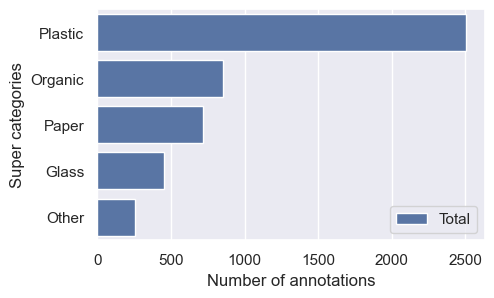

In [7]:
# Count annotations
super_cat_histogram = np.zeros(len(cat_table_id.keys()),dtype=int)
for ann in anns:
    cat_id = ann['category_id']
    supercat_id = [super_cat_id for super_cat_id in cat_table_id.keys() if cat_id in cat_table_id[super_cat_id]][0]
    super_cat_histogram[supercat_id] +=1

print(cat_table_id.keys())
print(cat_table_name.keys())
print(super_cat_histogram)

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(5,3))

# Convert to DataFrame
d ={'Super categories': cat_table_name.keys(), 'Number of annotations': super_cat_histogram}
print(d)
df = pd.DataFrame(d)
df = df.sort_values(by='Number of annotations', axis=0, ascending=False)

# sns.set_color_codes("pastel")
# sns.set(style="whitegrid")
plot_1 = sns.barplot(x="Number of annotations", y="Super categories", data=df,
            label="Total", color="b")
#plot_1.set_title('Annotations per super category',fontsize=20) 

## 3. Visualize Annotated Images


For simplicity, to select and show the dataset images with the respective masks, we make use of the COCO API.
The script below shows how to load and visualize an image with all its annotations.

Unfortunately, several python libraries do not take into account the EXIF orientation tag, thus we have to explicitly rotate the images. Alternatively you can use instead OpenCV.

274
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
batch_11/000028.jpg


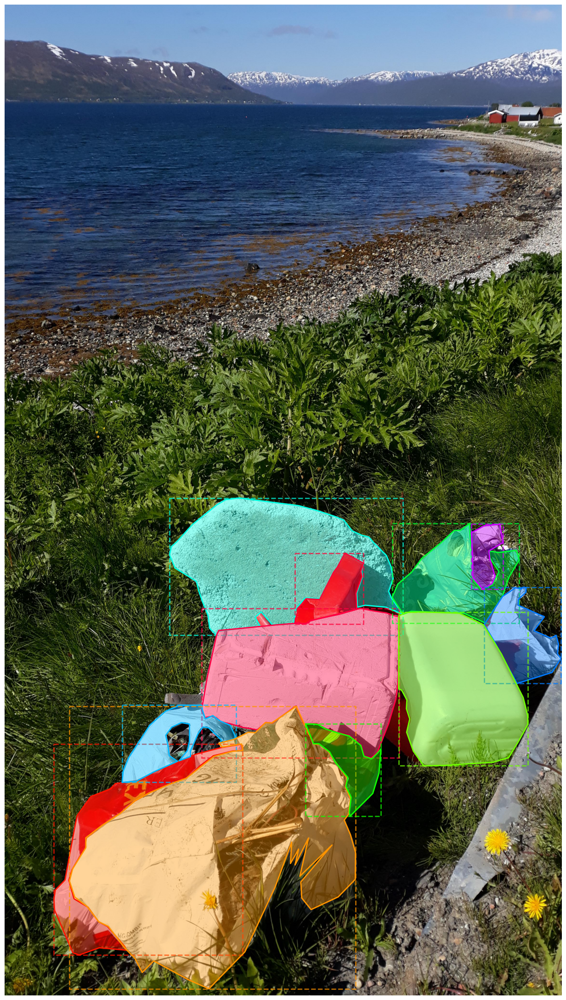

In [8]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
image_filepath = 'batch_11/000028.jpg'
pylab.rcParams['figure.figsize'] = (28,28)
####################

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        print(orientation)
        break

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Find image id
img_id = -1
for img in imgs:
    if img['file_name'] == image_filepath:
        img_id = img['id']
        break

# Show image and corresponding annotations
if img_id == -1:
    print('Incorrect file name')
else:

    # Load image
    print(image_filepath)
    I = Image.open(dataset_path + '/' + image_filepath)

    # Load and process image metadata
    if I._getexif():
        exif = dict(I._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                I = I.rotate(180,expand=True)
            if exif[orientation] == 6:
                I = I.rotate(270,expand=True)
            if exif[orientation] == 8:
                I = I.rotate(90,expand=True)

    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img_id, catIds=[], iscrowd=None)
    anns_sel = coco.loadAnns(annIds)

    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()



## Check if ´´I = ImageOps.exif_transpose(I)´´fix the issue

loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
batch_11/000028.jpg
[{'id': 755, 'image_id': 229, 'category_id': 57, 'segmentation': [[1225.0, 2087.0, 976.0, 2055.0, 921.0, 2062.0, 885.0, 2083.0, 783.0, 2165.0, 717.0, 2238.0, 695.0, 2257.0, 687.0, 2292.0, 710.0, 2347.0, 752.0, 2373.0, 799.0, 2403.0, 809.0, 2443.0, 822.0, 2481.0, 848.0, 2547.0, 854.0, 2598.0, 882.0, 2627.0, 891.0, 2610.0, 1064.0, 2589.0, 1044.0, 2552.0, 1069.0, 2530.0, 1116.0, 2584.0, 1204.0, 2579.0, 1214.0, 2517.0, 1251.0, 2472.0, 1315.0, 2475.0, 1369.0, 2366.0, 1385.0, 2345.0, 1419.0, 2285.0, 1495.0, 2329.0, 1487.0, 2362.0, 1491.0, 2382.0, 1467.0, 2452.0, 1470.0, 2510.0, 1502.0, 2502.0, 1589.0, 2510.0, 1659.0, 2540.0, 1613.0, 2474.0, 1600.0, 2444.0, 1619.0, 2390.0, 1610.0, 2341.0, 1591.0, 2295.0, 1539.0, 2243.0, 1518.0, 2218.0, 1487.0, 2210.0, 1448.0, 2192.0, 1413.0, 2147.0, 1373.0, 2131.0, 1300.0, 2107.0]], 'area': 328728.0, 'bbox': [687.0, 2055.0, 972.0, 572.0], 'iscrowd': 0}, {'id

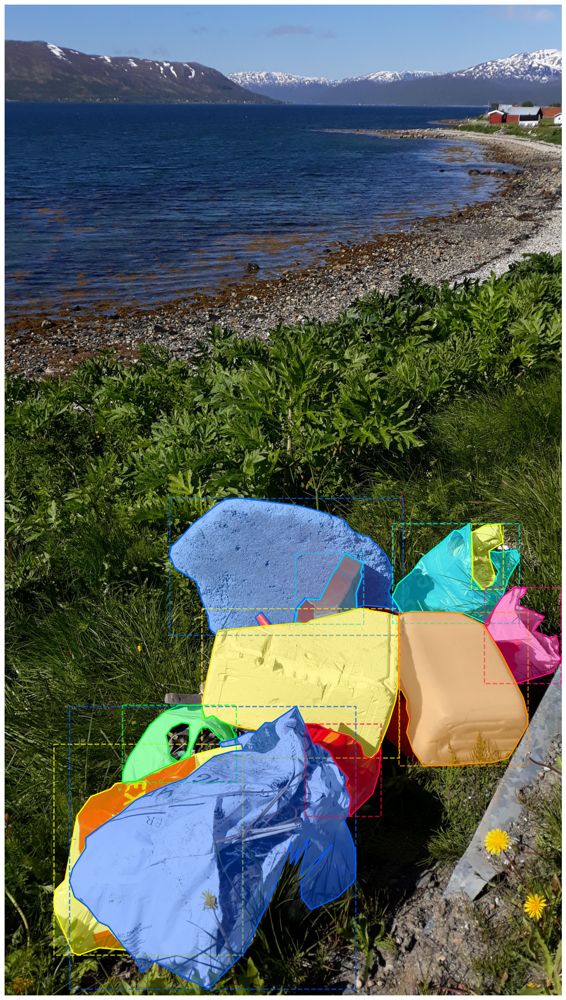

In [39]:
from PIL import Image, ExifTags, ImageOps
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
image_filepath = 'batch_11/000028.jpg'
pylab.rcParams['figure.figsize'] = (28,28)
####################

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Find image id
img_id = -1
for img in imgs:
    if img['file_name'] == image_filepath:
        img_id = img['id']
        break

# Show image and corresponding annotations
if img_id == -1:
    print('Incorrect file name')
else:

    # Load image
    print(image_filepath)
    I = Image.open(dataset_path + '/' + image_filepath)

    ########################################
    I = ImageOps.exif_transpose(I)
    ########################################

    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img_id, catIds=[], iscrowd=None)
    anns_sel = coco.loadAnns(annIds)

    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()

It is clear that the result is the same, this means that this 1 line of code prevents the shape issue. Let's check if this happen...

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
The image filepath: batch_11/000028.jpg corresponds to id: 176
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
(4128, 2322, 3)
(4128, 2322)
[0 1 2]
{np.uint64(0): (0, 0, 0), np.uint64(1): (np.int64(223), np.int64(185), np.int64(209)), np.uint64(2): (np.int64(147), np.int64(39), np.int64(36))}
[  0  36  39 147 185 209 223]


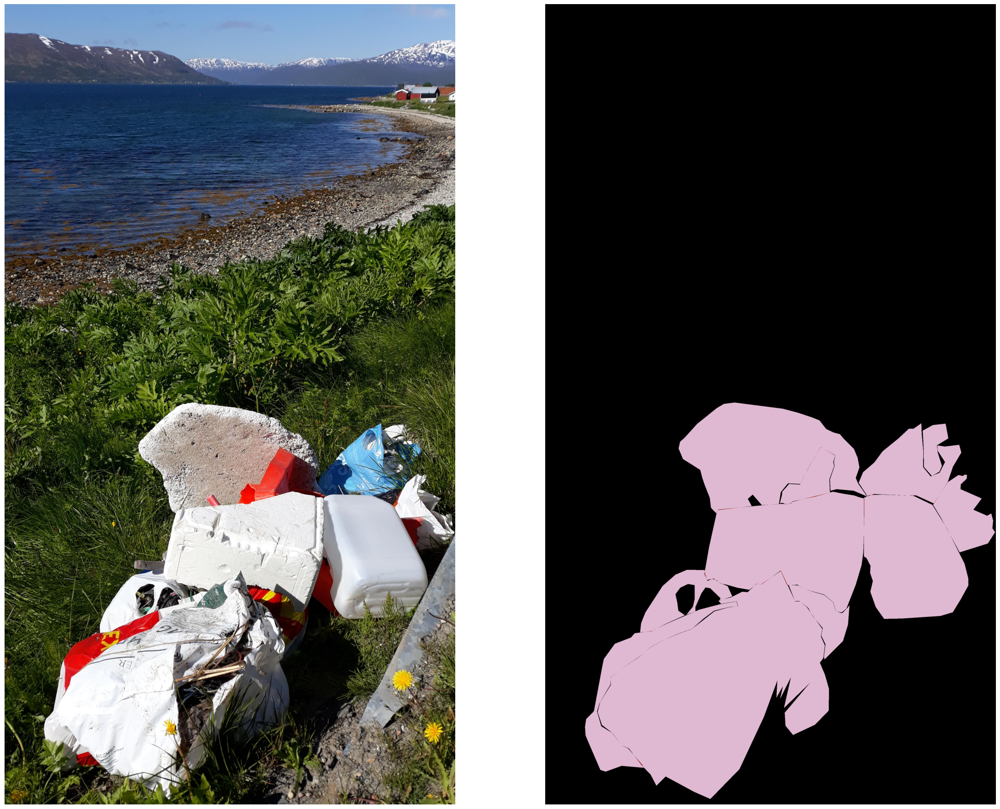

In [42]:
from pycocotools.coco import COCO
import os
from datasets.taco_dataset import TacoDataset
from utilities.config_utils import TaskType

image_filepath = "batch_11/000028.jpg"

# Get the annotations file
annotations_file = os.path.join("data", "train_annotations.json")
# Create a COCO object
coco_data = COCO(annotations_file)
img_ids = list(coco_data.imgs.keys())

item_nr = 0
for id in img_ids:
    img_coco_data = coco_data.loadImgs(id)[0]
    if img_coco_data['file_name'] == image_filepath:
        break
    item_nr += 1

print(f"The image filepath: {image_filepath} corresponds to id: {item_nr}")

dataset = TacoDataset(annotations_file=annotations_file, img_dir="data", task=TaskType["SEGMENTATION"])
img, masks = dataset[item_nr]
print(img.shape)

# Combine all masks
# Apply the mapping to transform the array
for i, mask in enumerate(masks, start=1):
    value_map = {0: 0, 1: i}
    mask = np.vectorize(value_map.get)(mask)
masks = np.sum(masks, axis=2)
print(masks.shape)

# Get unique labels
unique_labels = np.unique(masks)
print(unique_labels)

# Generate random colors for each unique label except 0 (black)
color_map = {label: (0, 0, 0) if label == 0 else tuple(np.random.randint(0, 256, 3)) for label in unique_labels}
print(color_map)

# Convert segmentation map to a color image
color_image = np.zeros((*masks.shape, 3), dtype=np.uint64)
for label, color in color_map.items():
    color_image[masks == label] = color
print(np.unique(color_image))

# Show image
fig,ax = plt.subplots(1, 2)
plt.axis('off')
ax[0].imshow(img)
ax[0].axis('off')
ax[1].imshow(color_image)
ax[1].axis('off')
plt.show()

## Check all shapes img vs masks
Print only the rotated images or masks that do not have the same shape.
If no issues, nothing should be printed.

In [25]:
# Get the annotations file
annotations_file = os.path.join("data", "train_annotations.json")

# Create the dataset
dataset = TacoDataset(annotations_file=annotations_file, img_dir="data", task=TaskType["SEGMENTATION"])

for idx, (img, masks) in enumerate(dataset):
    if masks.shape[:2] != img.shape[:2]:
        print(f"{masks.shape} vs {img.shape} at index {idx}")
print("ALL DATA EXPLORED.")


loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
ALL DATA EXPLORED.


The script below shows how to filter images by either category or supercategory.

Go ahead and try different (super)categories searches by changing the `category_name`.
Note that small objects may be hard to see.

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Number of images found:  74


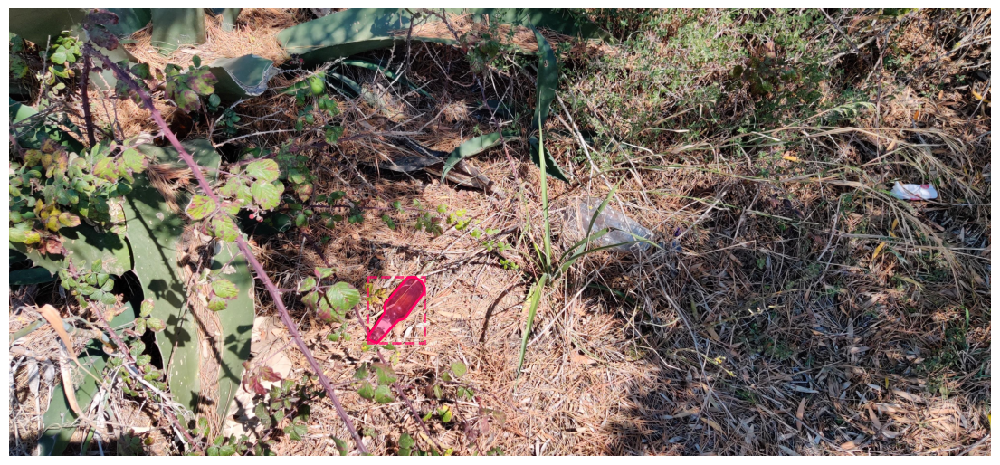

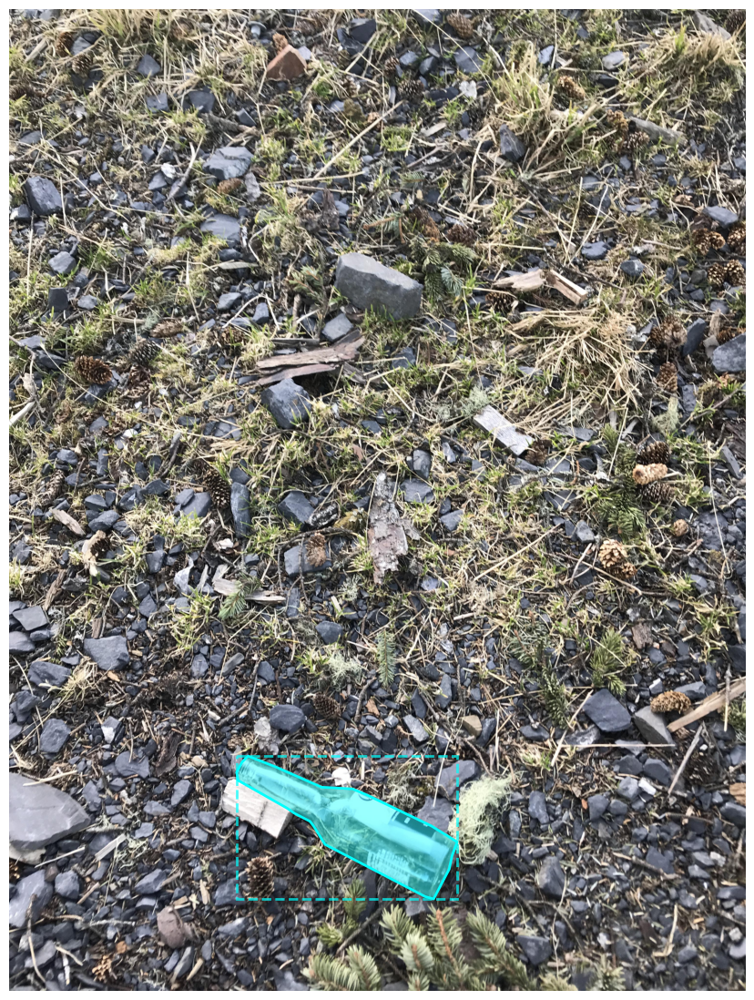

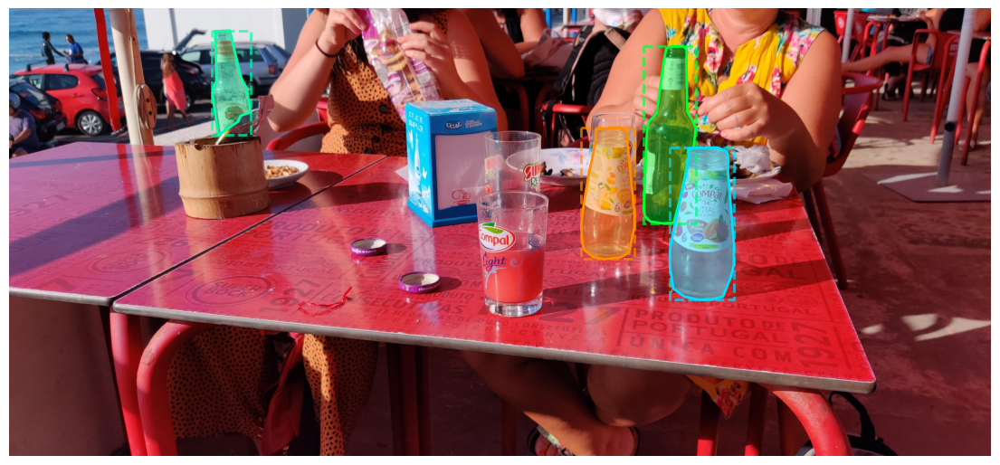

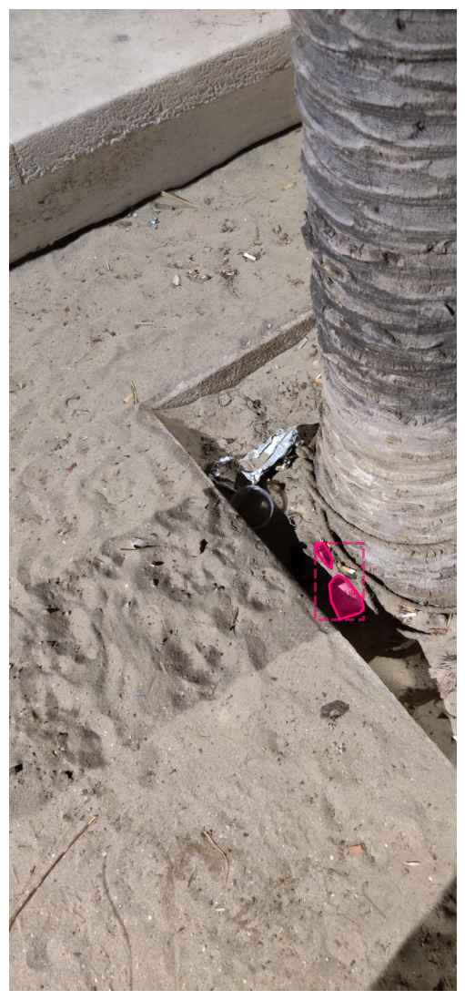

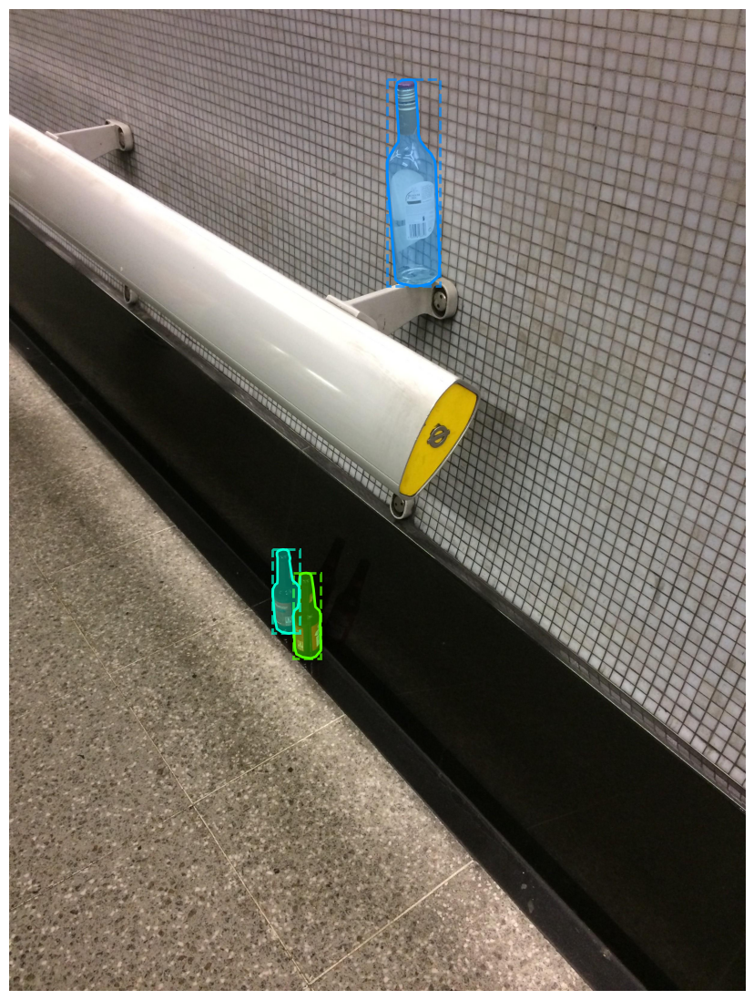

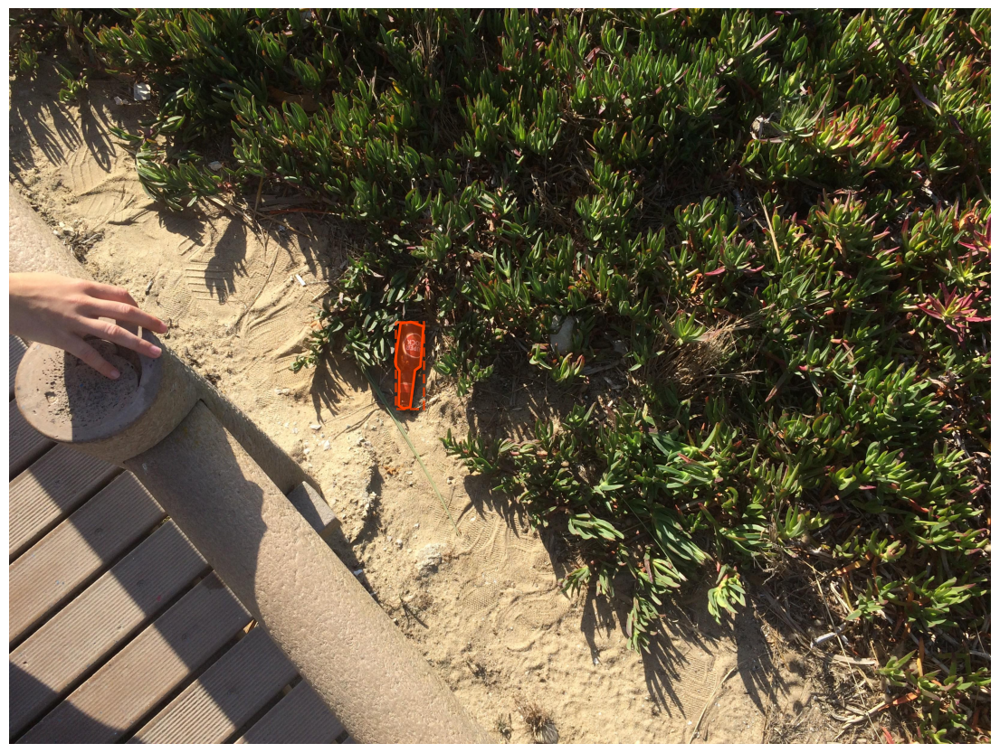

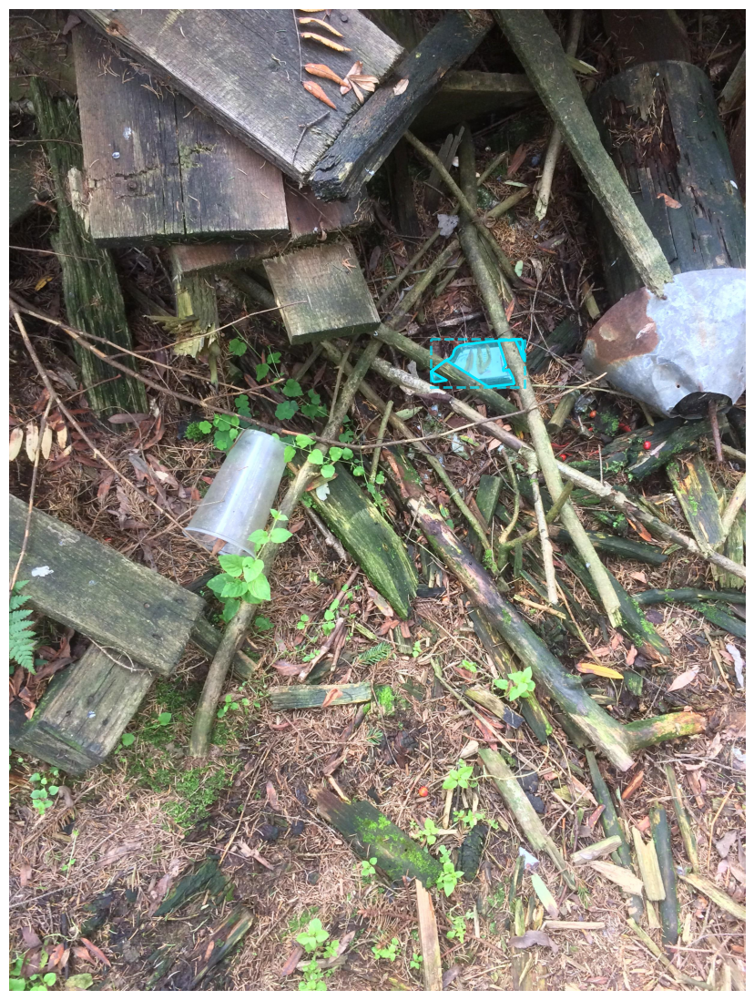

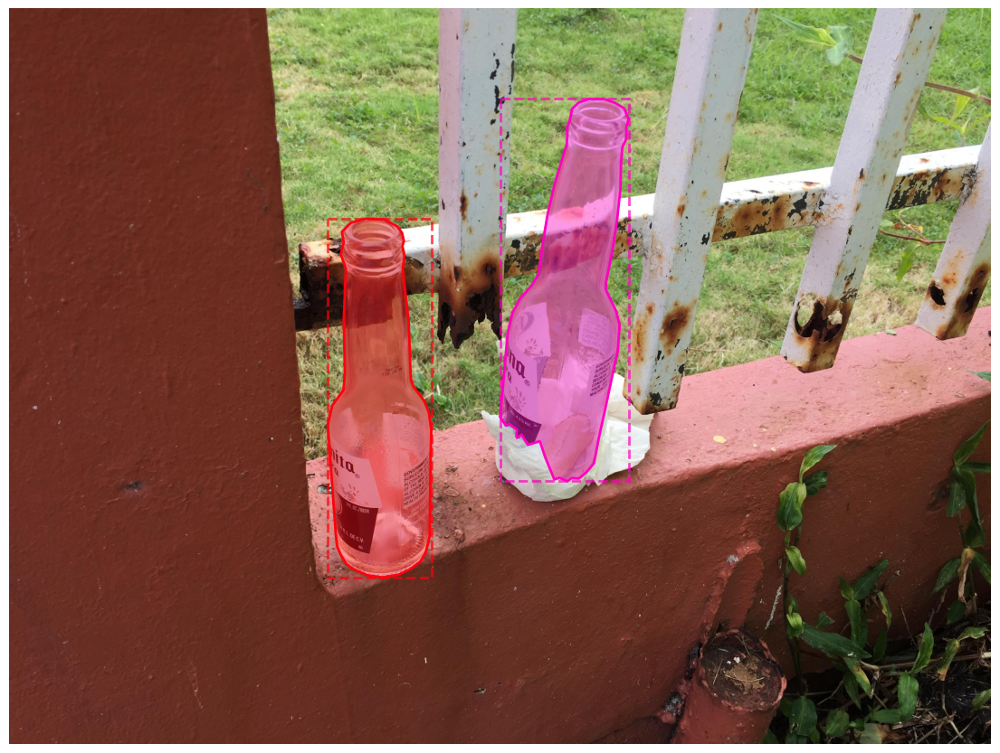

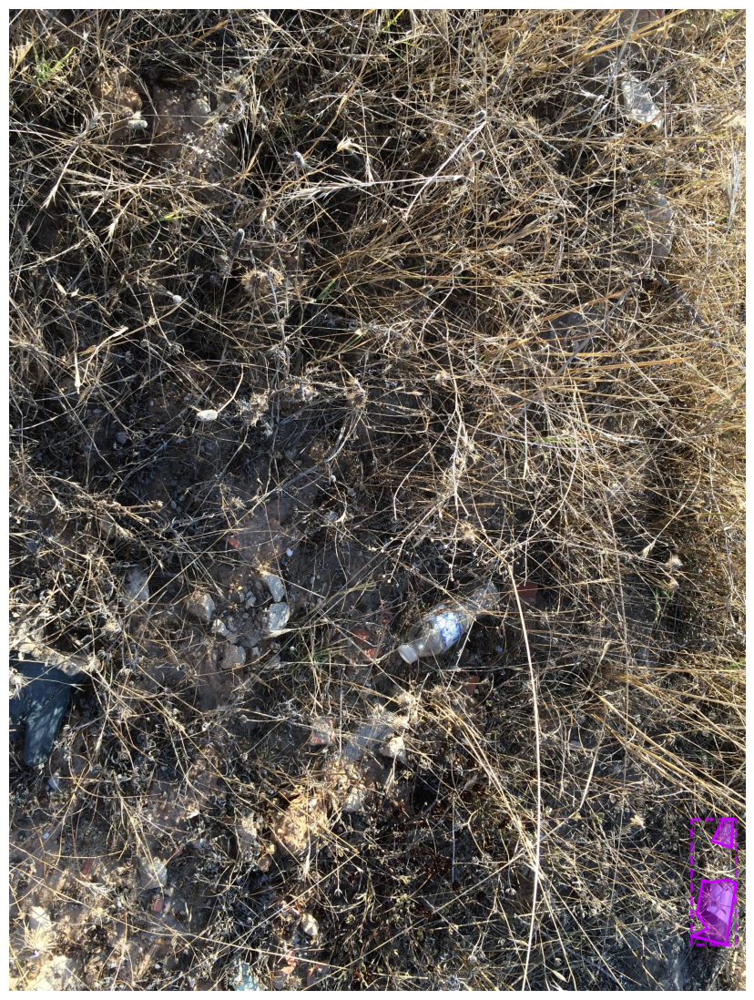

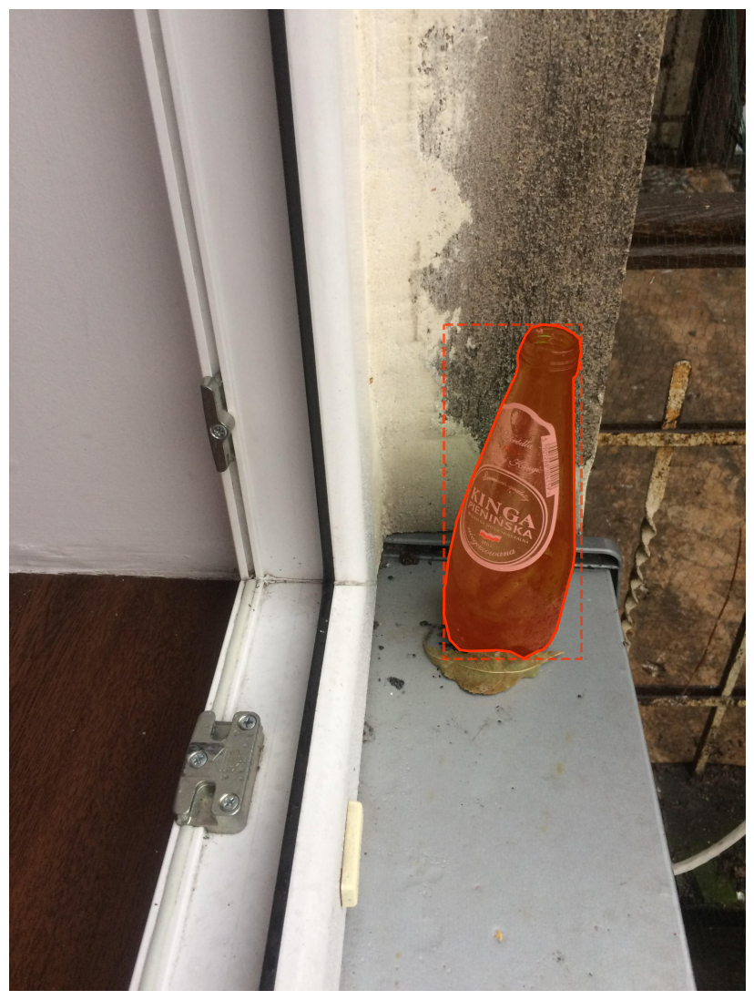

In [ ]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

# User settings
nr_img_2_display = 10
category_name = 'Glass bottle' #'Bottle'#  --- Insert the name of one of the categories or super-categories above
pylab.rcParams['figure.figsize'] = (14,14)
####################

# Obtain Exif orientation tag code
for orientation in ExifTags.TAGS.keys():
    if ExifTags.TAGS[orientation] == 'Orientation':
        break

# Loads dataset as a coco object
coco = COCO(anns_file_path)

# Get image ids
imgIds = []
catIds = coco.getCatIds(catNms=[category_name])
if catIds:
    # Get all images containing an instance of the chosen category
    imgIds = coco.getImgIds(catIds=catIds)
else:
    # Get all images containing an instance of the chosen super category
    catIds = coco.getCatIds(supNms=[category_name])
    for catId in catIds:
        imgIds += (coco.getImgIds(catIds=catId))
    imgIds = list(set(imgIds))

nr_images_found = len(imgIds) 
print('Number of images found: ',nr_images_found)

# Select N random images
random.shuffle(imgIds)
imgs = coco.loadImgs(imgIds[0:min(nr_img_2_display,nr_images_found)])

for img in imgs:
    image_path = dataset_path + '/' + img['file_name']
    # Load image
    I = Image.open(image_path)
    
    # Load and process image metadata
    if I._getexif():
        exif = dict(I._getexif().items())
        # Rotate portrait and upside down images if necessary
        if orientation in exif:
            if exif[orientation] == 3:
                I = I.rotate(180,expand=True)
            if exif[orientation] == 6:
                I = I.rotate(270,expand=True)
            if exif[orientation] == 8:
                I = I.rotate(90,expand=True)
    
    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # Load mask ids
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns_sel = coco.loadAnns(annIds)
    
    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()
